In [1]:
@show VERSION
@time using DifferentialEquations
@time using Plots
@time using ProgressMeter
@time using Fmt # pkg> add https://github.com/bicycle1885/Fmt.jl

VERSION = v"1.8.0-DEV.57"
  9.584537 seconds (27.06 M allocations: 1.866 GiB, 5.27% gc time)
  4.078480 seconds (8.99 M allocations: 632.175 MiB, 11.18% gc time, 2.47% compilation time)
  0.006112 seconds (9.43 k allocations: 557.039 KiB)
  0.003580 seconds (5.03 k allocations: 444.227 KiB)


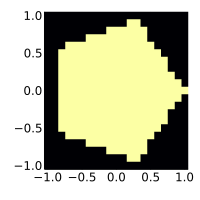

In [2]:
x ⪅ y = x < y || x ≈ y

function isin_ngon(n, R, x, y)
    α = 2π/n
    θ = mod(angle(x + im*y), α)
    r = √(x^2 + y^2) / R
    X, Y = r*cos(θ), r*sin(θ)
    (1 - cos(α))*Y ⪅ sin(α)*(1 - X)
end

isin_unit_pentagon(x, y) = isin_ngon(5, 1, x, y)

x = -1:0.1:1
y = -1:0.1:1
D = isin_unit_pentagon.(x, y')
heatmap(x, y, D'; colorbar=false, size=(200, 200))

In [3]:
module My

struct Param{TX, TY, TH, TV, TE, TB, TV_dic}
    x::TX
    y::TY
    h⁻¹::TH
    h⁻²::TH
    V::TV
    E::TE
    B::TB
    V_dic::TV_dic
end

Base.length(p::Param) = length(p.V)
Base.size(p::Param) = (length(p.x), length(p.y))

mystep(x::AbstractVector) = x[2] - x[1]
mystep(x::StepRangeLen) = step(x)

function Param(isin_func, x::AbstractVector, y::AbstractVector)
    @assert mystep(x) == mystep(y)
    h⁻¹ = 1/mystep(x)
    h⁻² = 1/mystep(x)^2
    I, J = eachindex(x), eachindex(y)
    D = isin_func.(x, y')
    V = Tuple{Int64, Int64}[]
    E_mat = [Tuple{Int64, Int64}[] for i in I, j in J]
    B_mat = [Tuple{Int64, Int64}[] for i in I, j in J]
    for j in J, i in I
        if D[i, j]
            push!(V, (i, j))
            for (p, q) in ((-1, 0), (1, 0), (0, -1), (0, 1))
                if i+p in I && j+q in J && D[i+p, j+q]
                    push!(E_mat[i, j], (i+p, j+q))
                else
                    D[i-p, j-q] && push!(B_mat[i, j], (i-p, j-q))
                end
            end
        end
    end
    V_dic = Dict(V[k] => k for k in eachindex(V))
    E = [getindex.(Ref(V_dic), E_mat[V[k]...]) for k in eachindex(V)]
    B = [getindex.(Ref(V_dic), B_mat[V[k]...]) for k in eachindex(V)]
    Param(x, y, h⁻¹, h⁻², V, E, B, V_dic)
end

function vec2mat!(p::Param, u, U)
    (; V) = p
    for k in eachindex(V)
        U[V[k]...] = u[k]
    end
    U
end
    
function vec2mat(p::Param, u; default_value=NaN)
    U = fill(eltype(u)(default_value), size(p))
    vec2mat!(p, u, U)
end

function mat2vec!(p::Param, U, u)
    (; V_dic) = p
    for t in keys(V_dic)
        u[V_dic[t]] = U[t...]
    end
    u
end

function mat2vec(p::Param, U)
    u = similar(eltype(U)[], length(p))
    mat2vec!(p, U, u)
end

end

x = -1:0.1:1
y = -1:0.1:1
p = My.Param(isin_unit_pentagon, x, y)

(; h⁻², V, E, B) = p
@show h⁻²

for k in (18, 19, 32, 131)
    @show k
    @show V[k]
    @show E[k]
    @show B[k]
    @show V[E[k]]
    @show V[B[k]]
    println("-"^80)
end

u0 = collect(1.0:length(V))
U0 = Int.(My.vec2mat(p, u0; default_value=0))
@show My.mat2vec(p, U0) == u0
U0'

h⁻² = 99.99999999999999
k = 18
V[k] = (4, 5)
E[k] = [19, 32]
B[k] = [19, 32]
V[E[k]] = [(5, 5), (4, 6)]
V[B[k]] = [(5, 5), (4, 6)]
--------------------------------------------------------------------------------
k = 19
V[k] = (5, 5)
E[k] = [18, 20, 33]
B[k] = [33]
V[E[k]] = [(4, 5), (6, 5), (5, 6)]
V[B[k]] = [(5, 6)]
--------------------------------------------------------------------------------
k = 32
V[k] = (4, 6)
E[k] = [31, 33, 18, 47]
B[k] = Int64[]
V[E[k]] = [(3, 6), (5, 6), (4, 5), (4, 7)]
V[B[k]] = Tuple{Int64, Int64}[]
--------------------------------------------------------------------------------
k = 131
V[k] = (21, 11)
E[k] = [130]
B[k] = [130]
V[E[k]] = [(20, 11)]
V[B[k]] = [(20, 11)]
--------------------------------------------------------------------------------
My.mat2vec(p, U0) == u0 = true


21×21 adjoint(::Matrix{Int64}) with eltype Int64:
 0  0    0    0    0    0    0    0  …    0    0    0    0    0    0    0
 0  0    0    0    0    0    0    0       0    0    0    0    0    0    0
 0  0    0    0    0    0    0    0       8    0    0    0    0    0    0
 0  0    0    0    0    0    9   10      17    0    0    0    0    0    0
 0  0    0   18   19   20   21   22      29   30    0    0    0    0    0
 0  0   31   32   33   34   35   36  …   43   44   45    0    0    0    0
 0  0   46   47   48   49   50   51      58   59   60   61    0    0    0
 0  0   62   63   64   65   66   67      74   75   76   77    0    0    0
 0  0   78   79   80   81   82   83      90   91   92   93   94    0    0
 0  0   95   96   97   98   99  100     107  108  109  110  111  112    0
 0  0  113  114  115  116  117  118  …  125  126  127  128  129  130  131
 0  0  132  133  134  135  136  137     144  145  146  147  148  149    0
 0  0  150  151  152  153  154  155     162  163  164  165  16

In [4]:
function anim_sol2D(sol; L=201, fps=20, fn="tmp.gif",
        clim=(-0.06, 0.06), color=:bwr, bg=:lightgray)
    (; prob, u) = sol
    (; tspan, p) = prob
    (; x, y) = p
    ts = range(tspan...; length=L) |> r -> [fill(r[1], 20); r; fill(r[end], 20)]
    prog = Progress(length(ts), 0)
    anim = @animate for t in ts
        U = My.vec2mat(p, sol(t).x[2])
        heatmap(x, y, U'; colorbar=false, clim, color, bg)
        title!(f"t = {$t:4.2f}"; titlefontsize=12)
        plot!(size=(420, 440), xlim=extrema(x), ylim=extrema(y), aspectratio=1)
        next!(prog)
    end
    gif(anim, fn; fps)
end

function plot_sol(sol, t; zlim=(-0.06, 0.06),
        color=:bwr, bg=:lightgray, camera=(30, 85), size=(640, 480), kwargs...)
    (; prob, u) = sol
    (; tspan, p) = prob
    (; x, y) = p
    U = My.vec2mat(p, sol(t).x[2])
    surface(x, y, U'; colorbar=false, zlim, color, bg, camera, size)
    title!(f"t = {$t:5.2f}"; titlefontsize=12)
    plot!(; kwargs...)
end

function anim_sol(sol; L=101, fps=10, fn="tmp.gif", zlim=(-0.06, 0.06),
        color=:bwr, bg=:lightgray, camera=(30, 85), size=(640, 480), kwargs...)
    (; prob, u) = sol
    (; tspan, p) = prob
    (; x, y) = p
    umin = minimum(minimum(u.x[2]) for u in u)
    umax = maximum(maximum(u.x[2]) for u in u)
    ts = range(tspan...; length=L) |> r -> [fill(r[1], 20); r; fill(r[end], 20)]
    prog = Progress(length(ts), 0)
    anim = @animate for t in ts
        plot_sol(sol, t; color, bg, camera, size, zlim, kwargs...)
        next!(prog)
    end
    gif(anim, fn; fps)
end

anim_sol (generic function with 1 method)

In [5]:
function g!(dv, v, u, p, t)
    (; h⁻², E) = p
    @inbounds for k in eachindex(dv)
        dv[k] = h⁻² * sum(u[l] - u[k] for l in E[k])
    end
end

function g_dirichlet!(dv, v, u, p, t)
    (; h⁻², E) = p
    @inbounds for k in eachindex(dv)
        dv[k] = h⁻² * (
            sum(u[l] - u[k] for l in E[k]; init=0.0) - (4 - length(E[k])) * u[k]
        )
    end
end

function g_neumann!(dv, v, u, p, t)
    (; h⁻², E, B) = p
    @inbounds for k in eachindex(dv)
        dv[k] = h⁻² * (
            sum(u[l] - u[k] for l in E[k]; init=0.0) + sum(u[l] - u[k] for l in B[k]; init=0.0)
        )
    end
end

function g_absorbing!(dv, v, u, p, t)
    (; h⁻¹, h⁻², E, B) = p
    @inbounds for k in eachindex(dv)
        dv[k] = h⁻² * (
            sum(u[l] - u[k] for l in E[k]; init=0.0) + sum(u[l] - u[k] for l in B[k]; init=0.0)
        ) - h⁻¹ * 2length(B[k]) * v[k]
    end
end

g_absorbing! (generic function with 1 method)

In [6]:
x = y = range(-1, 1; length=21)
p = My.Param(isin_unit_pentagon, x, y)
tspan = (0.0, 2.0)

F(a, b, c, x, y) = exp(-((x-a)^2+(y-b)^2)/(2c^2))
f(x, y) = F(0.4, 0.1, 0.1, x, y)
U0 = f.(x, y')
V0 = zero(U0)

u0 = My.mat2vec(p, U0)
v0 = My.mat2vec(p, V0);

In [7]:
tspan = (0.0, 2.0)
prob = SecondOrderODEProblem(g_dirichlet!, v0, u0, tspan, p)

sol = nothing; GC.gc()
@time sol = solve(prob; saveat=0.01)

(; u) = sol
umin = minimum(minimum(u.x[2]) for u in u)
umax = maximum(maximum(u.x[2]) for u in u)
@show umin, umax;

  7.714291 seconds (34.25 M allocations: 1.803 GiB, 6.24% gc time)
(umin, umax) = (-0.3874525897519451, 1.0)


Progress: 100%|█████████████████████████████████████████| Time: 0:00:08m
┌ Info: Saved animation to 
│   fn = D:\OneDrive\public\0006\wave eq on pentagon with dirichlet bc 2d Part 4.gif
└ @ Plots D:\.julia\packages\Plots\FKcum\src\animation.jl:104


Plots.AnimatedGif("D:\\OneDrive\\public\\0006\\wave eq on pentagon with dirichlet bc 2d Part 4.gif")
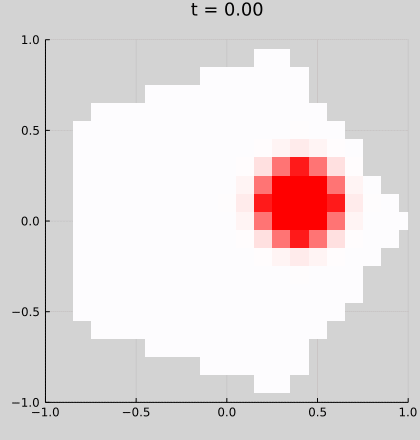

In [8]:
anim_sol2D(sol; fn="wave eq on pentagon with dirichlet bc 2d Part 4.gif", clim=(-0.15, 0.15))

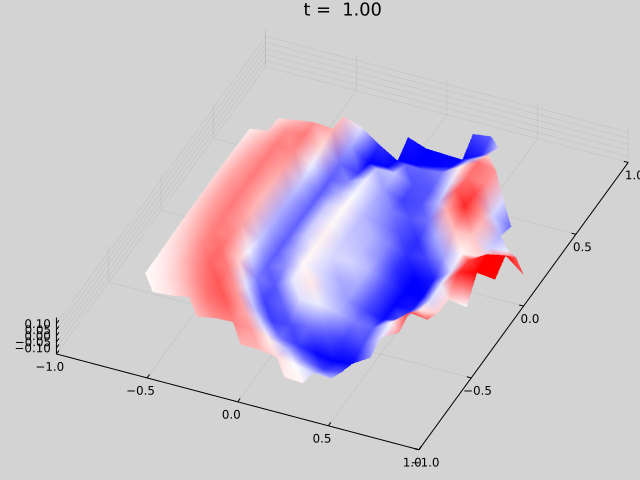

In [9]:
plot_sol(sol, 1.0; zlim=(-0.15, 0.15))

Progress: 100%|█████████████████████████████████████████| Time: 0:01:56
┌ Info: Saved animation to 
│   fn = D:\OneDrive\public\0006\wave eq on pentagon with dirichlet bc Part 4.gif
└ @ Plots D:\.julia\packages\Plots\FKcum\src\animation.jl:104


Plots.AnimatedGif("D:\\OneDrive\\public\\0006\\wave eq on pentagon with dirichlet bc Part 4.gif")
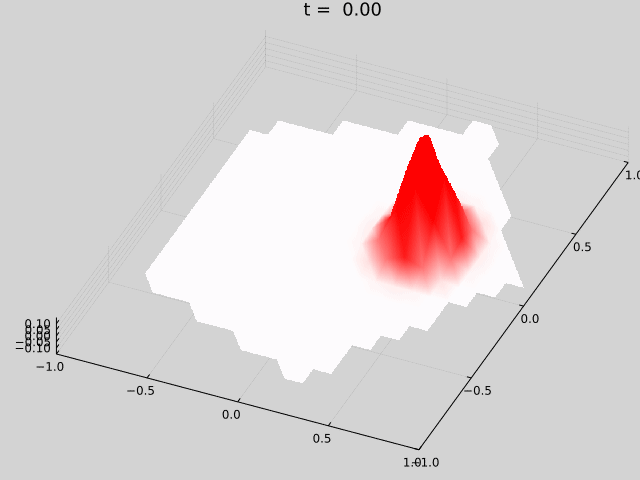

In [10]:
anim_sol(sol; fn="wave eq on pentagon with dirichlet bc Part 4.gif", zlim=(-0.15, 0.15))

In [11]:
tspan = (0.0, 2.0)
prob = SecondOrderODEProblem(g_neumann!, v0, u0, tspan, p)

sol = nothing; GC.gc()
@time sol = solve(prob; saveat=0.01)

(; u) = sol
umin = minimum(minimum(u.x[2]) for u in u)
umax = maximum(maximum(u.x[2]) for u in u)
@show umin, umax;

  3.887366 seconds (9.72 M allocations: 529.318 MiB, 2.20% gc time)
(umin, umax) = (-0.5741831482610902, 1.0)


Progress: 100%|█████████████████████████████████████████| Time: 0:00:06
┌ Info: Saved animation to 
│   fn = D:\OneDrive\public\0006\wave eq on pentagon with neumann 2d bc Part 4.gif
└ @ Plots D:\.julia\packages\Plots\FKcum\src\animation.jl:104


Plots.AnimatedGif("D:\\OneDrive\\public\\0006\\wave eq on pentagon with neumann 2d bc Part 4.gif")
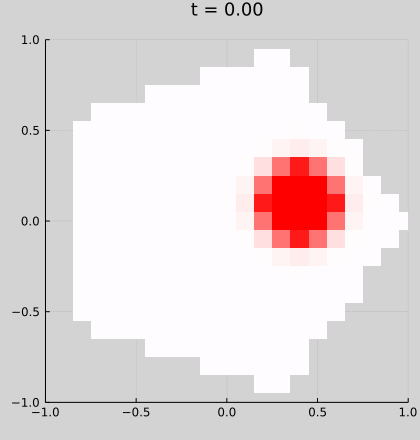

In [12]:
anim_sol2D(sol; fn="wave eq on pentagon with neumann 2d bc Part 4.gif", clim=(-0.15, 0.15))

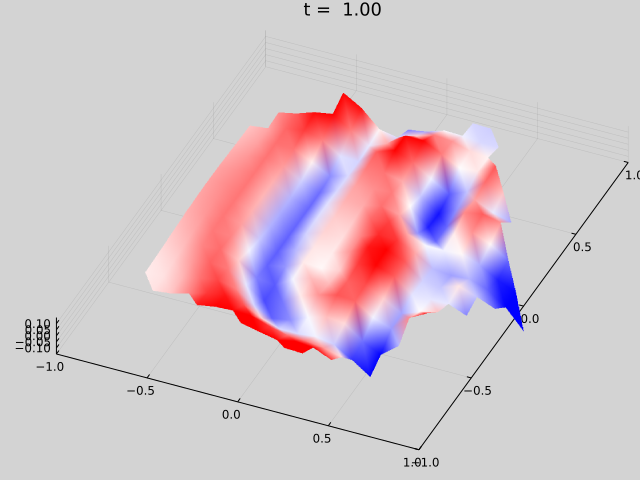

In [13]:
plot_sol(sol, 1.0; zlim=(-0.15, 0.15))

Progress: 100%|█████████████████████████████████████████| Time: 0:02:00
┌ Info: Saved animation to 
│   fn = D:\OneDrive\public\0006\wave eq on pentagon with neumann bc Part 4.gif
└ @ Plots D:\.julia\packages\Plots\FKcum\src\animation.jl:104


Plots.AnimatedGif("D:\\OneDrive\\public\\0006\\wave eq on pentagon with neumann bc Part 4.gif")
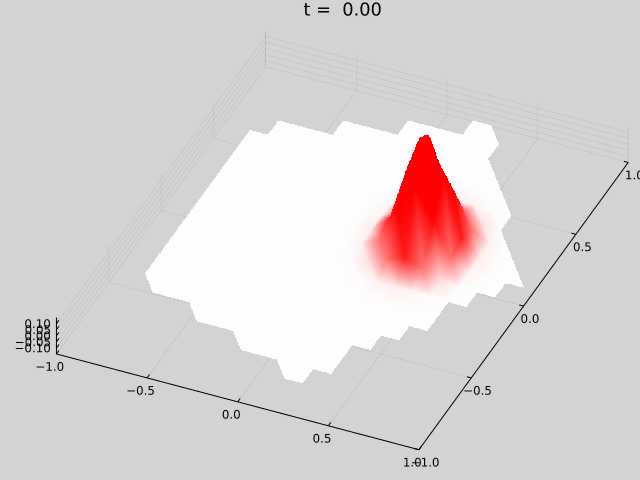

In [14]:
anim_sol(sol; fn="wave eq on pentagon with neumann bc Part 4.gif", zlim=(-0.15, 0.15))

In [15]:
tspan = (0.0, 3.0)
prob = SecondOrderODEProblem(g_absorbing!, v0, u0, tspan, p)

sol = nothing; GC.gc()
@time sol = solve(prob; saveat=0.01)

(; u) = sol
umin = minimum(minimum(u.x[2]) for u in u)
umax = maximum(maximum(u.x[2]) for u in u)
@show umin, umax;

  3.984103 seconds (9.73 M allocations: 529.906 MiB, 2.32% gc time)
(umin, umax) = (-0.3874436877202537, 1.0)


Progress: 100%|█████████████████████████████████████████| Time: 0:00:08
┌ Info: Saved animation to 
│   fn = D:\OneDrive\public\0006\wave eq on pentagon with absorbing bc 2d Part 4.gif
└ @ Plots D:\.julia\packages\Plots\FKcum\src\animation.jl:104


Plots.AnimatedGif("D:\\OneDrive\\public\\0006\\wave eq on pentagon with absorbing bc 2d Part 4.gif")
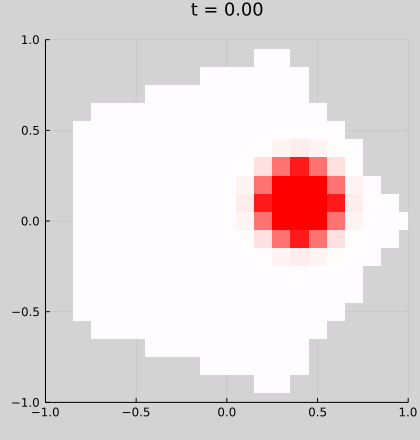

In [16]:
anim_sol2D(sol; L=301, fn="wave eq on pentagon with absorbing bc 2d Part 4.gif", clim=(-0.15, 0.15))

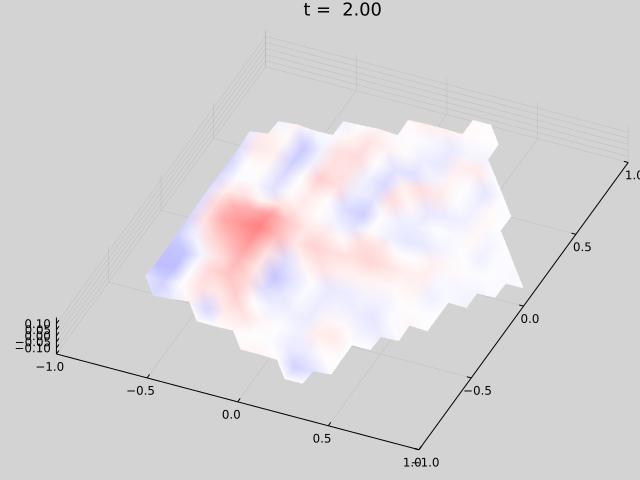

In [17]:
plot_sol(sol, 2.0; zlim=(-0.15, 0.15))

Progress: 100%|█████████████████████████████████████████| Time: 0:02:43
┌ Info: Saved animation to 
│   fn = D:\OneDrive\public\0006\wave eq on pentagon with absorbing bc Part 4.gif
└ @ Plots D:\.julia\packages\Plots\FKcum\src\animation.jl:104


Plots.AnimatedGif("D:\\OneDrive\\public\\0006\\wave eq on pentagon with absorbing bc Part 4.gif")
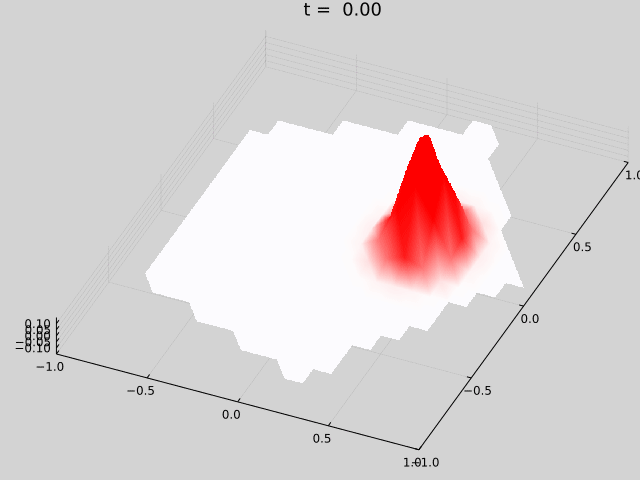

In [18]:
anim_sol(sol; L=151, fn="wave eq on pentagon with absorbing bc Part 4.gif", zlim=(-0.15, 0.15))